[INFO] Missing image for M05506_Well1 at DIV 25
[INFO] Missing image for M05506_Well1 at DIV 28
[INFO] Missing image for M05506_Well1 at DIV 32
[INFO] Missing image for M05506_Well3 at DIV 28
[INFO] Missing image for M05506_Well3 at DIV 32
[INFO] Missing image for M05506_Well6 at DIV 11
[INFO] Missing image for M05506_Well6 at DIV 14
[INFO] Missing image for M05506_Well6 at DIV 18
[INFO] Missing image for M05506_Well6 at DIV 21
[INFO] Missing image for M05506_Well6 at DIV 25
[INFO] Missing image for M05506_Well6 at DIV 28
[INFO] Missing image for M05506_Well6 at DIV 32
[INFO] Missing image for M08018_Well1 at DIV 11
[INFO] Missing image for M08018_Well2 at DIV 11
[INFO] Missing image for M08018_Well3 at DIV 11
[INFO] Missing image for M08018_Well4 at DIV 11
[INFO] Missing image for M08018_Well5 at DIV 11
[INFO] Missing image for M08018_Well6 at DIV 11


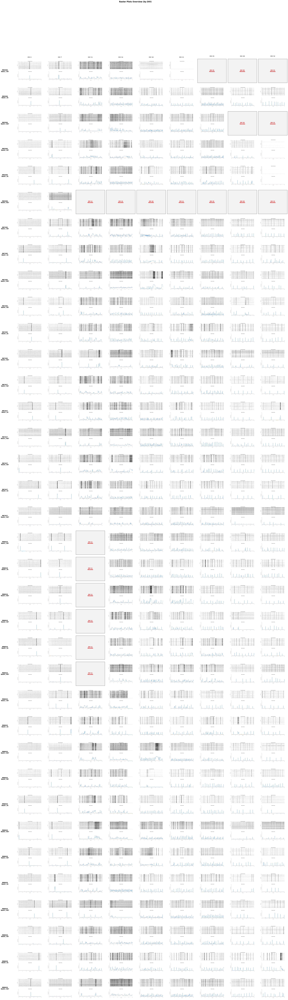


✅ Overview saved to: /Users/mandarmp/Documents/CDKL5Paper/Fig6_dataCrunching/CDKL5_R59X_T1/Raster_BurstActivity_Overview3.pdf


In [1]:
import os
import re
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# === PATHS ===
root_path = "/Users/mandarmp/Documents/CDKL5Paper/Fig6_dataCrunching/CDKL5_R59X_T1/Network_outputs/Raster_BurstActivity"
output_pdf = "/Users/mandarmp/Documents/CDKL5Paper/Fig6_dataCrunching/CDKL5_R59X_T1/Raster_BurstActivity_Overview3.pdf"

# === HELPERS ===
def extract_div_from_filename(filename):
    match = re.search(r'_DIV(\d+)_', filename)
    return int(match.group(1)) if match else None

def extract_genotype_from_filename(filename):
    match = re.search(r'_DIV\d+_(\w+)\.png$', filename)
    return match.group(1) if match else "?"

def parse_chip_label(chip_folder_name, filename):
    parts = chip_folder_name.split('_')
    chip_id = parts[0] if len(parts) > 0 else chip_folder_name
    well_name = parts[1] if len(parts) > 1 else ""
    genotype = extract_genotype_from_filename(filename)
    return f"{chip_id}\n{well_name} | {genotype}"

# === STEP 1: GATHER IMAGES BY CHIP_WELL AND DIV ===
chip_dirs = [d for d in os.listdir(root_path) if os.path.isdir(os.path.join(root_path, d))]
images_dict = {}
all_divs = set()

for chip in sorted(chip_dirs):
    img_dir = os.path.join(root_path, chip, "Plot60s", "png")
    if not os.path.isdir(img_dir):
        print(f"[WARNING] Missing png folder for {chip}")
        continue

    png_files = sorted([f for f in os.listdir(img_dir) if f.endswith('.png')])
    div_map = {}

    for f in png_files:
        div = extract_div_from_filename(f)
        if div is not None:
            if div in div_map:
                print(f"[WARNING] Duplicate DIV {div} found for {chip} → {f}")
            else:
                div_map[div] = os.path.join(img_dir, f)
                all_divs.add(div)
        else:
            print(f"[WARNING] Couldn't extract DIV from filename {f} in {chip}")

    if len(div_map) == 0:
        print(f"[WARNING] No valid DIV images found in {chip}")
        continue

    images_dict[chip] = div_map

# === STEP 2: SORT DIVs and Prepare Layout ===
all_divs = sorted(all_divs)
n_rows = len(images_dict)
n_cols = len(all_divs)

# === STEP 3: PLOT ===
fig, axs = plt.subplots(n_rows, n_cols, figsize=(4.2 * n_cols, 3.5 * n_rows), squeeze=False)

for i, (chip, div_map) in enumerate(images_dict.items()):
    # Pick any one file from the chip folder to extract genotype info
    sample_filename = os.path.basename(next(iter(div_map.values())))
    label = parse_chip_label(chip, sample_filename)

    for j, div in enumerate(all_divs):
        ax = axs[i][j]
        img_path = div_map.get(div, None)

        if img_path and os.path.isfile(img_path):
            img = mpimg.imread(img_path)
            ax.imshow(img)
            ax.axis('off')
        else:
            ax.text(0.5, 0.5, f"DIV {div}\nMISSING", ha='center', va='center', color='red', fontsize=10, weight='bold')
            ax.set_facecolor("#f2f2f2")
            ax.set_xticks([])
            ax.set_yticks([])
            print(f"[INFO] Missing image for {chip} at DIV {div}")

    # Label only once per row (left of first subplot)
    axs[i][0].annotate(
        label,
        xy=(0, 0.5),
        xycoords='axes fraction',
        xytext=(-0.35, 0.5),
        textcoords='axes fraction',
        ha='center',
        va='center',
        fontsize=11,
        fontweight='bold'
    )

# === Column titles: DIV ===
for j, div in enumerate(all_divs):
    axs[0][j].set_title(f"DIV {div}", fontsize=12, pad=20)

plt.subplots_adjust(left=0.12, right=0.98, top=0.94, bottom=0.05, wspace=0.05, hspace=0.1)
plt.suptitle("Raster Plots Overview (by DIV)", fontsize=16, weight='bold', y=0.995)
plt.savefig(output_pdf, format='pdf', dpi=150)
plt.show()

print(f"\n✅ Overview saved to: {output_pdf}")

[INFO] Missing image for M05506_Well1 at DIV 25
[INFO] Missing image for M05506_Well1 at DIV 28
[INFO] Missing image for M05506_Well1 at DIV 32
[INFO] Missing image for M05506_Well3 at DIV 28
[INFO] Missing image for M05506_Well3 at DIV 32
[INFO] Missing image for M05506_Well6 at DIV 11
[INFO] Missing image for M05506_Well6 at DIV 14
[INFO] Missing image for M05506_Well6 at DIV 18
[INFO] Missing image for M05506_Well6 at DIV 21
[INFO] Missing image for M05506_Well6 at DIV 25
[INFO] Missing image for M05506_Well6 at DIV 28
[INFO] Missing image for M05506_Well6 at DIV 32
[INFO] Missing image for M08018_Well1 at DIV 11
[INFO] Missing image for M08018_Well2 at DIV 11
[INFO] Missing image for M08018_Well3 at DIV 11
[INFO] Missing image for M08018_Well4 at DIV 11
[INFO] Missing image for M08018_Well5 at DIV 11
[INFO] Missing image for M08018_Well6 at DIV 11


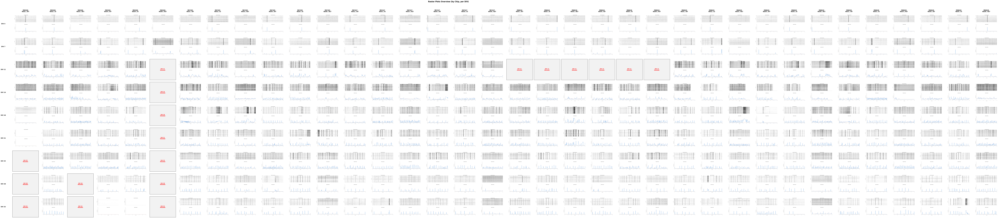


✅ Overview (flipped) saved to: /Users/mandarmp/Documents/CDKL5Paper/Fig6_dataCrunching/CDKL5_R59X_T1/Raster_BurstActivity_Overview3_flipped.pdf


: 

In [ ]:
import os
import re
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# === PATHS ===
root_path = "/Users/mandarmp/Documents/CDKL5Paper/Fig6_dataCrunching/CDKL5_R59X_T1/Network_outputs/Raster_BurstActivity"
output_pdf = "/Users/mandarmp/Documents/CDKL5Paper/Fig6_dataCrunching/CDKL5_R59X_T1/Raster_BurstActivity_Overview3_flipped.pdf"

# === HELPERS ===
def extract_div_from_filename(filename):
    match = re.search(r'_DIV(\d+)_', filename)
    return int(match.group(1)) if match else None

def extract_genotype_from_filename(filename):
    match = re.search(r'_DIV\d+_(\w+)\.png$', filename)
    return match.group(1) if match else "?"

def parse_chip_label(chip_folder_name, filename):
    parts = chip_folder_name.split('_')
    chip_id = parts[0] if len(parts) > 0 else chip_folder_name
    well_name = parts[1] if len(parts) > 1 else ""
    genotype = extract_genotype_from_filename(filename)
    return f"{chip_id}\n{well_name} | {genotype}"

# === STEP 1: GATHER IMAGES BY CHIP_WELL AND DIV ===
chip_dirs = [d for d in os.listdir(root_path) if os.path.isdir(os.path.join(root_path, d))]
images_dict = {}
all_divs = set()

for chip in sorted(chip_dirs):
    img_dir = os.path.join(root_path, chip, "Plot60s", "png")
    if not os.path.isdir(img_dir):
        print(f"[WARNING] Missing png folder for {chip}")
        continue

    png_files = sorted([f for f in os.listdir(img_dir) if f.endswith('.png')])
    div_map = {}

    for f in png_files:
        div = extract_div_from_filename(f)
        if div is not None:
            if div in div_map:
                print(f"[WARNING] Duplicate DIV {div} found for {chip} → {f}")
            else:
                div_map[div] = os.path.join(img_dir, f)
                all_divs.add(div)
        else:
            print(f"[WARNING] Couldn't extract DIV from filename {f} in {chip}")

    if len(div_map) == 0:
        print(f"[WARNING] No valid DIV images found in {chip}")
        continue

    images_dict[chip] = div_map

# === STEP 2: SORT DIVs and Prepare Layout ===
all_divs = sorted(all_divs)
n_rows = len(all_divs)             # DIVs become rows
n_cols = len(images_dict)          # Chips become columns
chip_list = list(images_dict.keys())

# === STEP 3: PLOT ===
fig, axs = plt.subplots(n_rows, n_cols, figsize=(4.0 * n_cols, 3.2 * n_rows), squeeze=False)

for j, chip in enumerate(chip_list):
    div_map = images_dict[chip]
    sample_filename = os.path.basename(next(iter(div_map.values())))
    label = parse_chip_label(chip, sample_filename)

    for i, div in enumerate(all_divs):
        ax = axs[i][j]
        img_path = div_map.get(div, None)

        if img_path and os.path.isfile(img_path):
            img = mpimg.imread(img_path)
            ax.imshow(img)
            ax.axis('off')
        else:
            ax.text(0.5, 0.5, f"DIV {div}\nMISSING", ha='center', va='center', color='red', fontsize=10, weight='bold')
            ax.set_facecolor("#f2f2f2")
            ax.set_xticks([])
            ax.set_yticks([])
            print(f"[INFO] Missing image for {chip} at DIV {div}")

    # Label each column with chip info (on top of first row)
    axs[0][j].set_title(label, fontsize=11, weight='bold', pad=18)

# === Row labels: DIVs on left ===
for i, div in enumerate(all_divs):
    axs[i][0].annotate(
        f"DIV {div}",
        xy=(0, 0.5),
        xycoords='axes fraction',
        xytext=(-0.35, 0.5),
        textcoords='axes fraction',
        ha='center',
        va='center',
        fontsize=12,
        fontweight='bold'
    )

plt.subplots_adjust(left=0.12, right=0.98, top=0.94, bottom=0.05, wspace=0.05, hspace=0.1)
plt.suptitle("Raster Plots Overview (by Chip, per DIV)", fontsize=16, weight='bold', y=0.995)
plt.savefig(output_pdf, format='pdf', dpi=150)
plt.show()

print(f"\n✅ Overview (flipped) saved to: {output_pdf}")